# Рынок заведений общественного питания Москвы

В данном проекте мы исследуем рынок общественного питания в городе Москве. Оно будет состоять из двух частей. В первой части мы проанализируем представленность в городе различных видов заведений, отношение сетевых и несетевых, изучим рейтинги и средний чек. Во второй части мы дадим рекомендации для открытия нового заведения.По результатам проведенного исследования-подготовим презентацию.

## Обзор данных.

In [1]:
#загружаем необходимые библиотеки
import pandas as pd
import plotly.express as px
from plotly import graph_objects as go
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
#открываем файл
df=pd.read_csv('moscow_places.csv')

In [3]:
df.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


У нас есть информация о 8406 заведениях питания в Москве. О каждом заведении представлена следующая информация: название заведения, его категория, адрес, дни и часы работы, координаты места, рейтинг, категория цен, средний чек, оценка среднего чека,средняя цена чашки капучино, сетевое или нет, количество посадочных мест. Типы данных столбцов соответствуют представленной в столбцах информации.

## Предобработка данных.

In [5]:
# посмотрим, есть ли дубликаты
df.duplicated().sum()

0

In [6]:
df['name_lower']=df['name'].str.lower()
df['address_lower']=df['address'].str.lower()

In [7]:
df[['name_lower','address_lower']].duplicated().sum()

4

In [8]:
df=df.drop_duplicates(subset=['name_lower','address_lower'])

In [9]:
#посмотрим, есть ли пропуски
df.isna().sum()

name                    0
category                0
address                 0
district                0
hours                 535
lat                     0
lng                     0
rating                  0
price                5087
avg_bill             4586
middle_avg_bill      5253
middle_coffee_cup    7867
chain                   0
seats                3610
name_lower              0
address_lower           0
dtype: int64

Полных дубликатов в данных нет. Есть большое количество пропусков в столбцах: часы работы, категория цен, средний чек, оценка среднего чека, средняя цена чашки капучино и количество посадочных мест. Пропусков в данных достаточно много: в некоторых столбцах более половины, поэтому мы не можем ни удалить пропуски, ни заполнить их, чтобы не искажать информацию. Поэтому оставим их без изменения.

In [10]:
#создадим столбец street с названиями улиц
def street(row):
    second_comma=row.find(',',7)
    address=row[8:second_comma]
    return address
df['street']=df['address'].apply(street)

<ipython-input-10-8054b92f8625>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['street']=df['address'].apply(street)


In [11]:
#создадим столбец с обозначением, что заведение работает ежедневно и круглосуточно
def daily(hours):
    if hours=='ежедневно, круглосуточно':
        return True
    else:
        return False
df['is_24/7']=df['hours'].apply(daily)

<ipython-input-11-ed3fd402f861>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['is_24/7']=df['hours'].apply(daily)


In [12]:
#заменим названия округов аббревиатурами
df['district'].unique()

array(['Северный административный округ',
       'Северо-Восточный административный округ',
       'Северо-Западный административный округ',
       'Западный административный округ',
       'Центральный административный округ',
       'Восточный административный округ',
       'Юго-Восточный административный округ',
       'Южный административный округ',
       'Юго-Западный административный округ'], dtype=object)

In [13]:
def categorize_district(row):
        if 'Северный административный округ' in row:
            return 'САО'
        elif 'Северо-Восточный административный округ' in row:
            return 'СВАО'
        elif 'Северо-Западный административный округ' in row:
            return 'СЗАО'
        elif 'Центральный административный округ' in row:
            return 'ЦАО'
        elif 'Восточный административный округ' in row:
            return 'ВАО'
        elif 'Восточный административный округ' in row:
            return 'ВАО'
        elif 'Юго-Восточный административный округ' in row:
            return 'ЮВАО'
        elif 'Южный административный округ' in row:
            return 'ЮАО'
        elif 'Юго-Западный административный округ' in row:
            return 'ЮЗАО'
            
df['district_abbr'] = df['district'].apply(categorize_district)     


In [14]:
df.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,name_lower,address_lower,street,is_24/7,district_abbr
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN,wowфли,"москва, улица дыбенко, 7/1",улица Дыбенко,False,САО
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,четыре комнаты,"москва, улица дыбенко, 36, корп. 1",улица Дыбенко,False,САО
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,хазри,"москва, клязьминская улица, 15",Клязьминская улица,False,САО
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,dormouse coffee shop,"москва, улица маршала федоренко, 12",улица Маршала Федоренко,False,САО
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,иль марко,"москва, правобережная улица, 1б",Правобережная улица,False,САО


Мы сделали предобработку данных и для дальнейшего анализа добавили столбец с улицами и столбец с данными о том, работает ли это заведение ежедневно и круглосуточно. Также для более компактного отображения информации на графиках мы заменили названия округов их аббревиатурой.

## Анализ рынка заведений общественного питания Москвы

In [15]:
# какие категории заведений представлены в данных 
df_category = pd.DataFrame(df['category'].value_counts()).reset_index()
fig=px.bar(df_category, x='index', y='category', title='Категории заведений')
fig.update_xaxes(title_text='Категории')
fig.update_yaxes(title_text='Количество')
fig.show() 

Больше всего в Москве кафе и ресторанов. Их количество вместе составляют более половины рынка все заведений питаний. Вторая половина поделена в порядке убывания доли между: кофейнями, барами, пиццериями, заведениями быстрого питания, столовыми и булочными. 

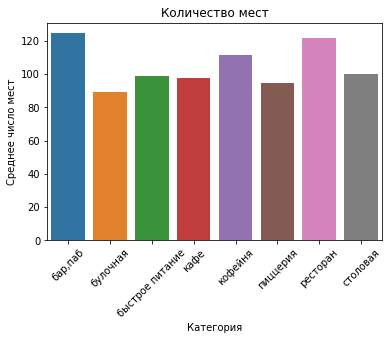

In [16]:
seats=df.groupby(['category'],as_index=False)['seats'].mean()
seats.columns=['category','seats']
sns.barplot(x='category',y='seats', data=seats)
plt.title('Количество мест')
plt.xlabel('Категория')
plt.ylabel('Среднее число мест')
plt.xticks(rotation=45)
plt.show()

In [17]:
seats

,category,seats
0,"бар,паб",124.477516
1,булочная,89.385135
2,быстрое питание,98.891117
3,кафе,97.365653
4,кофейня,111.199734
5,пиццерия,94.496487
6,ресторан,121.892041
7,столовая,99.750000


/usr/local/lib/python3.8/dist-packages/matplotlib/cbook/__init__.py:1376: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.



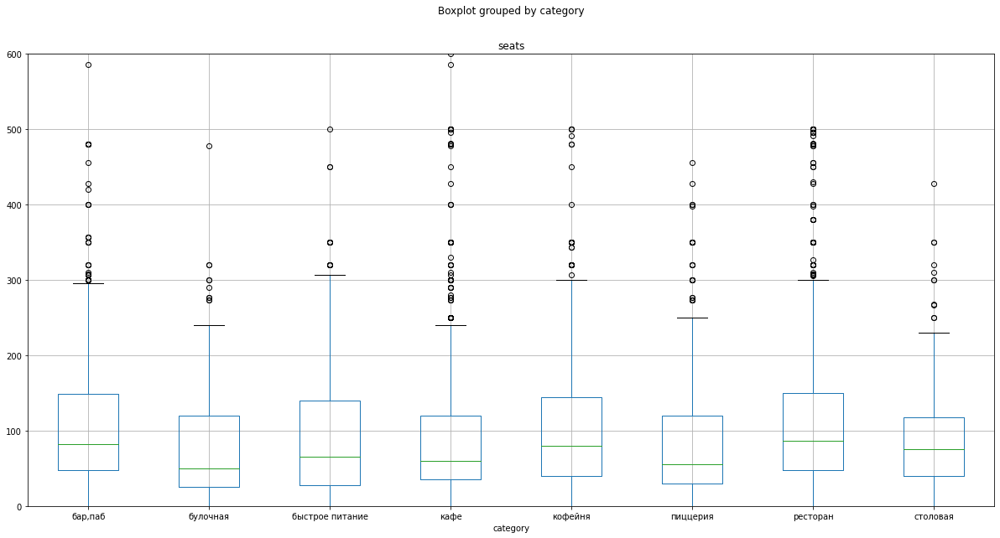

In [18]:
#строим boxplot
df.boxplot(column='seats',by='category',figsize=(20,10))
plt.ylim(0,600)
None

Среднее количество мест в заведениях питания не сильно различается по категориям. Оно колеблется от 89,4 до 124,5. Больше всего, около 120, у баров и ресторанов. Около 110, в среднем, мест у кофеен. И менее 100 у булочных, заведениях быстрого питания,кафе,пиццерий и столовых.

In [19]:
#сетевые и не сетевые
chain_count = pd.DataFrame(df['chain'].value_counts()).reset_index()
chain_count['index']=['не сетевое','сетевое']
fig = go.Figure(data=[go.Pie(labels=chain_count['index'],
                             values=chain_count['chain'])]) 
fig.update_layout(title='Соотношение сетевых и несетевых заведений', 
                  width=500,
                  height=300)
fig.show() 

Несетевых заведений примерно в 1,6 раза больше, чем не сетевых.

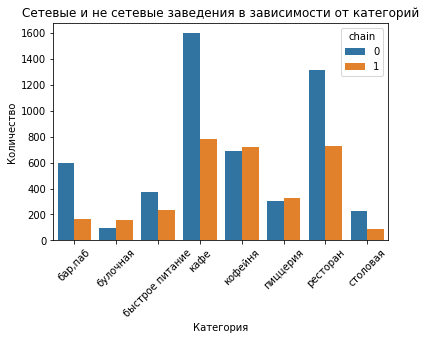

In [20]:
#какие категории чаще являются сетевыми
category_chain=df.groupby(['category','chain'],as_index=False)['name'].count()
category_chain.columns=['category','chain','count']
category_chain
sns.barplot(x='category', y='count', data=category_chain,hue='chain')
plt.title('Сетевые и не сетевые заведения в зависимости от категорий')
plt.xlabel('Категория')
plt.ylabel('Количество')
plt.xticks(rotation=45)

plt.show()

Среди кофеен, пиццерий и булочных чаще встречаются сетевые заведения, чем несетевые. Среди баров, заведений быстрого питания, кафе, столовых и ресторанов явно больше заведений не сетевых. 

In [21]:
#ТОП-15 популярных сетей в Москве
chain = df.loc[df['chain'] == True].groupby('name')[['name']].count()
chain.columns = ['count']
top_15= chain.reset_index().sort_values(by='count', ascending=False).head(15)

fig = px.bar(top_15.sort_values(by='count', ascending=True),
             x='count',
             y='name', 
             text='count')
fig.update_layout(title='ТОП-15 сетевых заведений',
                   xaxis_title='Количество заведений',
                   yaxis_title='Название сети')
fig.show() 

In [22]:
spisok=top_15['name']
df_15=df.query('name in @spisok')
df_15_grouped=df_15.groupby(['district_abbr','category'],as_index=False)['name'].count()
df_15_grouped.columns=['district_abbr','category','count']
fig = px.bar(df_15_grouped, x='district_abbr', y='count', title='Районы и категории заведений из ТОП-15',color='category',width=1000,height=600)
fig.update_xaxes(tickangle=45)
fig.show() 

In [23]:
# какие категории заведений представлены в топ-15 самых популярных сетей
df_15_category = pd.DataFrame(df_15['category'].value_counts()).reset_index()

fig=px.bar(df_15_category, x='index', y='category', title='Категории заведений')
fig.update_xaxes(title_text='Категории')
fig.update_yaxes(title_text='Количество')
fig.show()

In [24]:
len(df_15)

816

Мы отобрали 15 самых популярных сетевых заведений города Москвы. На их долю приходится 816 заведений, что составляет чуть менее 10% всего рынка. Самые популярные сети- это кофейни, на втором месте - рестораны, на третьем - пиццерии. Большинство из них сосредоточено в Центральном административном округе.

In [25]:
df_grouped=df.groupby(['district_abbr','category'],as_index=False)['name'].count()
df_grouped.columns=['district_abbr','category','count']
fig = px.bar(df_grouped, x='district_abbr', y='count', title='Районы и категории заведений',color='category',width=1000,height=600)
fig.update_xaxes(tickangle=45)
fig.show() 

Больше всего заведений питания города Москвы находятся в Центральном административном округе - более 2000. На втором месте - Восточный административный округ- с 1500 заведениями. Меньше всего- в СЗАО. В ЦАО также заметна популярность кофеин, ресторанов и пабов. В других округах заметно преобладание кафе, особенно в ВАО.

In [26]:
category_rating = df.groupby('category', as_index=False)['rating'].agg('mean')
category_rating['rating']=round(category_rating['rating'],2)
fig = px.bar(category_rating.sort_values(by='rating', ascending=True), x='category', y='rating', text='rating', 
             range_y=[3.8, 4.5])

fig.update_layout(title='Средний рейтинг разных категорий', xaxis_title='Категории', yaxis_title='Рейтинг')
fig.show() 

/usr/local/lib/python3.8/dist-packages/matplotlib/cbook/__init__.py:1376: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.



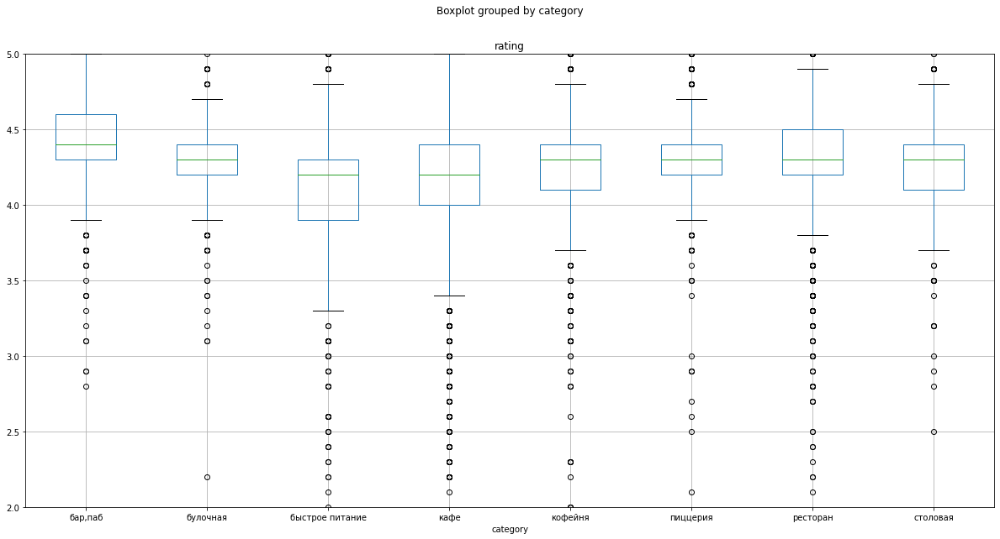

In [27]:
#строим boxplot
df.boxplot(column='rating',by='category',figsize=(20,10))
plt.ylim(2,5)
None

Средние рейтинги всех категорий заведений не сильно отличаются и колеблются между 4,05 (у заведений быстрого питания) и 4,39 (у баров и пабов).

In [28]:
#средний рейтинг заведений по районам
rating_df = df.groupby('district', as_index=False)['rating'].agg('mean')
# импортируем карту и хороплет
from folium import Map, Choropleth

# загружаем JSON-файл с границами округов Москвы
state_geo = 'admin_level_geomap.geojson'
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=rating_df,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний рейтинг заведений по районам',
).add_to(m)

# выводим карту
m

Самый лучший рейтинг- у заведений в Центральном административном округе. Там находятся лучшие заведения по мнению пользователей. ЦАО-особый район в Москве. Это самая густонаселенная часть города, каждый день миллионы людей приезжают на работу или по другим делам в центр. Больше всего заведений питания также находится там. Можно встретить места и эконом-класса, и самые дорогие в городе. Абсолютно все категории заведений встречаются в ЦАО: днем можно поесть в кафе или ресторане, а вечером и ночью отдохнуть в барах. Аренда площадей также самая высокая в ЦАО по сравнению с другими районами. Чуть меньший средний рейтинг заведений в Северном и Северо-западном алминистративном округе. Остальные районы имеют рейтинг между 4,15 и 4,19. Наименьший рейтинг у заведений в Юго-Восточном округе.

In [29]:
#все заведения Москвы на карте
# импортируем карту и маркер
from folium import Map, Marker
# импортируем кластер
from folium.plugins import MarkerCluster

# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
df.apply(create_clusters, axis=1)

# выводим карту
m

In [30]:
#ТОП-15 улиц по количеству заведений
streets_grouped = df.groupby('street')[['name']].count()
streets_grouped.columns = ['count']
streets_top_15= streets_grouped.reset_index().sort_values(by='count', ascending=False).head(15)

fig = px.bar(streets_top_15.sort_values(by='count', ascending=True),
             x='count',
             y='street', 
             text='count')
fig.update_layout(title='ТОП-15 улиц',
                   xaxis_title='Количество заведений',
                   yaxis_title='Название улицы')
fig.show() 

In [31]:
spisok_streets=streets_top_15['street']
df_streets_15=df.query('street in @spisok_streets')
df_streets_15_grouped=df_streets_15.groupby(['street','category'],as_index=False)['name'].count()
df_streets_15_grouped.columns=['street','category','count']


In [32]:
fig = px.bar(df_streets_15_grouped, x='street', y='count', title='Районы и категории заведений',color='category',width=1000,height=600)
fig.update_xaxes(tickangle=45)
fig.show()

Проспект Мира-рекордсмен среди всех улиц Москвы по количеству заведений: посетители этой улицы могут выбрать среди более, чем 180 заведений. На этих улицах преобладают рестораны, кафе и кофейни. Многие улицы являются основными транспортыми "артериями" города, которые связывают отдаленные районы с центром города. Все эти улицы очень оживленные.

In [33]:
street_grouped=df.groupby('street')[['name']].count()
street_grouped.columns=['count']
street_with_1=street_grouped.query('count==1')
street_with_1.head(20)

,count
street,
1-й Автозаводский проезд,1
1-й Балтийский переулок,1
1-й Варшавский проезд,1
1-й Вешняковский проезд,1
1-й Голутвинский переулок,1
1-й Грайвороновский проезд,1
1-й Дербеневский переулок,1
1-й Земельный переулок,1
1-й Капотнинский проезд,1


In [34]:
len(street_with_1)

479

В Москве есть около 500 улиц, на которых находится только 1 заведение питания. Эти улицы в основном находятся в спальных районах Москвы, на окраине.

In [35]:
#ценовой диапазон заведений по районам
middle_avg_bill=df.groupby('district')['middle_avg_bill'].median()
# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=middle_avg_bill,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Ценовой диапазон заведений по районам',
).add_to(m)

# выводим карту
m

Самый большой средний чек в среднем у заведений питания в Западном и Центральном административном округе-около 1000 рублей. Самые доступные цены- в Северном, Южном и Юго-Восточном округе.

**Вывод.**

- В Москве представлено более 8400 заведений, которые относятся к одной из 8 категорий: кафе, ресторан, кофейня, пиццерия, бар,быстрое питание, булочная, столовая. Около половины заведений представлено кафе и ресторанами.
- Количество посадочных мест-примерно от 90 до 120.
- Большинство заведений не относятся к сетевым: 62%. Кофейни и пиццерии чаще являются сетевыми заведениями чем несетевыми.
- Средний рейтинг московских заведений колеблется от 4 до 4,4. 
- На долю 15 самых популярных сетей приходится около 816 заведений, что составляет чуть менее 10% от всего рынка питания. 
- Самые дорогие заведения в Москве находятся в Центральном и Западном округе, а с самым лучшим рейтингом-в Центральном. 
- Самое большое количество заведений находится на Проспекте Мира.

## Открытие кофейни

In [36]:
#создадим отдельный датасет с кофейнями
df_coffee_house=df.query('category=="кофейня"')
len(df_coffee_house)

1413

Всего в городе находится 1413 кофеин, что составляет 16,8% от всех заведений города.

In [37]:
df_coffee_house_grouped=df_coffee_house.groupby('district',as_index=False)[['name']].count()
df_coffee_house_grouped.columns=['district','count']
# импортируем карту и хороплет
from folium import Map, Choropleth

# загружаем JSON-файл с границами округов Москвы
state_geo = 'admin_level_geomap.geojson'
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=df_coffee_house_grouped,
    columns=['district', 'count'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Разделение кофеин по районам',
).add_to(m)

# выводим карту
m

Больше всего кофеин находится в ЦАО-около 400, во всех остальных округах количество кофеин примерно одинаковое.

In [38]:
#круглосуточные и не круглосуточные
coffee_house_hours = pd.DataFrame(df['is_24/7'].value_counts()).reset_index()
coffee_house_hours['index']=['не круглосуточное','круглосуточное']
fig = go.Figure(data=[go.Pie(labels=coffee_house_hours['index'],
                             values=coffee_house_hours['is_24/7'])]) 
fig.update_layout(title='Соотношение круглосуточных и некруглосуточных кофеен', 
                  width=700,
                  height=300)
fig.show()

В основном кофейни в городе не работают круглосуточно.

In [39]:
#средний рейтинг кофеин по районам
rating_df_coffee_house = df_coffee_house.groupby('district', as_index=False)['rating'].agg('mean')
# импортируем карту и хороплет
from folium import Map, Choropleth

# загружаем JSON-файл с границами округов Москвы
state_geo = 'admin_level_geomap.geojson'
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=rating_df_coffee_house,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний рейтинг кофеен по районам',
).add_to(m)

# выводим карту
m

Мы видим значительное разнообразие в среднем рейтинге заведений в Москве. Самые любимые горожанами места находятся в Центральном, Северо-Западном и Северном административных округах. В Восточном и в Северо-западном округе ситуация хуже. Меньше всего показатели среднего рейтинга у кофеин в Западном,Северо-Восточном, Южном и Юго-Восточном округе.

In [40]:
df_coffee_house['middle_coffee_cup'].describe()

count     521.000000
mean      175.055662
std        89.753009
min        60.000000
25%       124.000000
50%       170.000000
75%       225.000000
max      1568.000000
Name: middle_coffee_cup, dtype: float64

Цена средней чашки капучино-175 рублей, медиана- 170 рублей. В Москве можно найти чашку кофе и за 1458 рублей, и за 60 рублей.
Цена чашки кофе в новом заведении будет зависеть от многих обстоятельств: категории заведения, его местоположении, ценовой политики и т.д. В общем можно порекомендовать не превышать цену чашки кофе более чем за 170 рублей в первое время после открытия кофейни.


**Вывод.**

Открытие кофейни в городе Москве - хорошая идея, которая может принести значительную прибыль. Москва- город с большими возможностями для предпринимательства. Почти половина наиболее успешных и популярных заведений в Москве- это кофейни. 
И местоположение, и режим работы, и количество посадочных мест и другие характеристики кофейни во многом зависят от общей идеи заведения: какая ценовая категория, на каких посетителей в первую очередь рассчитываем, какие идеи меню, дизайна и общей стилистики кафе есть. Попробуем дать примерные характеристики, подходящие будущему заведению.

Кофейня-та категория заведений для питания, которые в основном не предусматривают круглосуточного обслуживания. Поэтому рекомендуем открывать кофейню на дневные часы, но с захватом вечернего времени и выходных дней. Москва - город, в котором жители привыкли к открытым заведениям питания в выходные дни, и в будние до поздней ночи.

Хорошим районом для открытия является Центральный административный округ. Там проходят большие потоки людей, уже открыто много различных заведений. Минусами этого места считается высокая стоимость аренды и большая конкуренция. Так как инвесторы хотят заведение, похожее на кофейню в сериале "Друзья", то это должно быть заведение среднего ценового сегмента, рассчитанное на молодежную публику. И при высокой аренде в ЦАО оно может не окупиться.

Можно порекомендовать для открытия Северо-Западный округ. Там не такая высокая стоимость аренды, ценовой диапазон заведений примерно такой же как и у кофейни, которая готовится к открытию, а также хорошие отзывы у заведений, которые там уже находятся, и которые привлекают посетителей.
